In [1]:
#Importing libraries

#Libraries for data exploration and preparation
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import warnings
import cv2 as cv
import os 
import shutil

#Libraries for Model Building
import tensorflow as tf
from sklearn.model_selection import StratifiedKFold 
from sklearn.metrics import roc_curve, f1_score
import seaborn as sns
import math

#Libraries for performacnce visualization
import tensorflow_addons as tfa
import random
from sklearn.metrics import confusion_matrix



In [2]:
warnings.filterwarnings("ignore")

In [3]:
base_dir=r"/kaggle/input/animal-image-dataset-90-different-animals/animals/animals"

In [4]:
classes=os.listdir(base_dir)
print(classes)

['beetle', 'parrot', 'fox', 'wolf', 'hedgehog', 'turtle', 'snake', 'shark', 'horse', 'antelope', 'hamster', 'woodpecker', 'eagle', 'chimpanzee', 'bison', 'penguin', 'butterfly', 'sandpiper', 'hornbill', 'lion', 'lobster', 'oyster', 'otter', 'grasshopper', 'raccoon', 'dog', 'pigeon', 'donkey', 'hippopotamus', 'hummingbird', 'bear', 'coyote', 'bee', 'pig', 'rat', 'owl', 'caterpillar', 'koala', 'squid', 'hare', 'whale', 'mouse', 'tiger', 'fly', 'lizard', 'orangutan', 'bat', 'porcupine', 'kangaroo', 'gorilla', 'starfish', 'mosquito', 'crow', 'possum', 'goldfish', 'swan', 'elephant', 'sheep', 'dragonfly', 'zebra', 'seal', 'octopus', 'cow', 'ox', 'wombat', 'reindeer', 'panda', 'duck', 'goose', 'goat', 'badger', 'flamingo', 'crab', 'seahorse', 'rhinoceros', 'dolphin', 'okapi', 'moth', 'sparrow', 'pelecaniformes', 'squirrel', 'leopard', 'jellyfish', 'ladybugs', 'cockroach', 'hyena', 'cat', 'deer', 'turkey', 'boar']


## Exploring the dataset and selecting our classes

In [209]:
#Checking for Corrupted images
corrupted=[]
for Class in classes:
    class_path=os.path.join(base_dir,Class)
    for image in os.listdir(class_path):
        img=Image.open(os.path.join(class_path,image))
        try:
            img.verify()
        except:
            corrupted.append(image)

if not corrupted:
    print("Check done no corrupted images found!")
else:
    print("Corrupted images present")

Check done no corrupted images found!


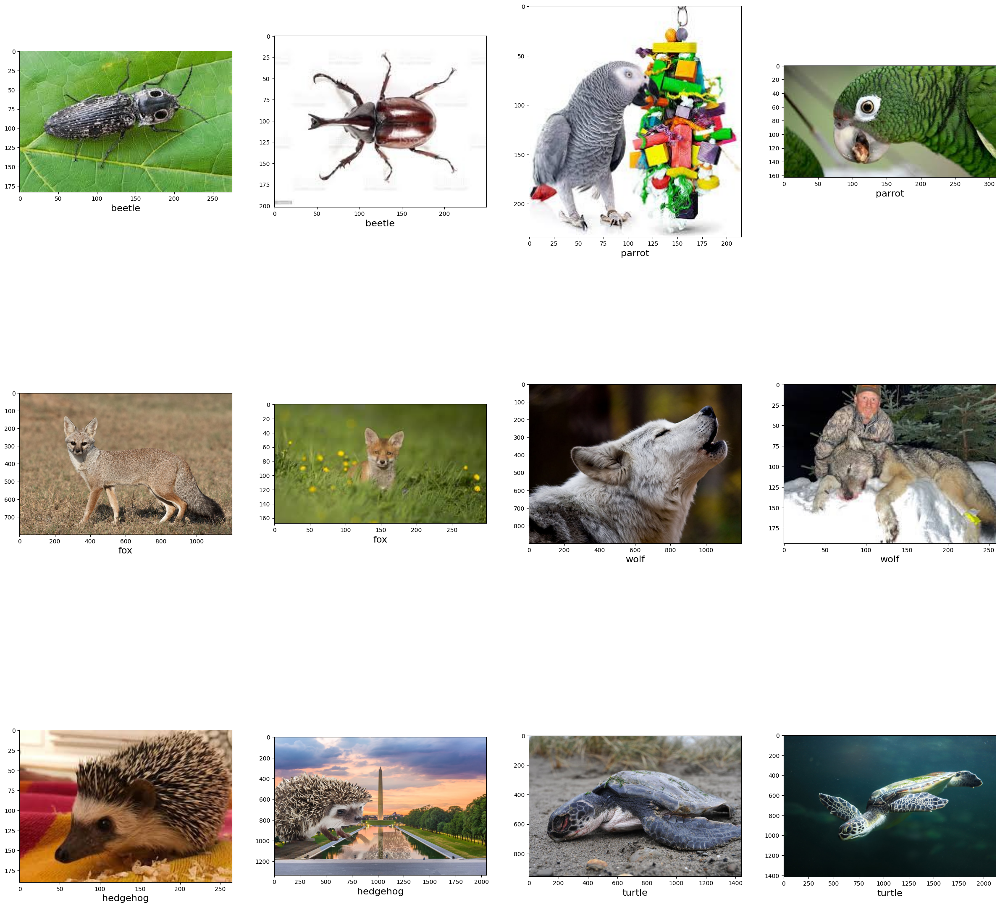

In [210]:
#Visualize images from each of the first six classes
fig,ax=plt.subplots(3,4, figsize=(30,30))
Class=0
disp=0
for i in range(3):
    for j in range(4):
        class_dir=os.path.join(base_dir,classes[Class])
        img=Image.open(os.path.join(class_dir,os.listdir(class_dir)[disp]))
        ax[i][j].imshow(img)
        ax[i][j].set_xlabel(classes[Class],fontsize=16)
        disp+=1
        if j%2!=0:
            Class+=1
            disp=0

In [211]:
#Notes

#1) The images seem to be fine and the dataset seems to not be corrupted
#2) The classes have images of different widths and heights
#3) The dimensions are not constant within the same class as well


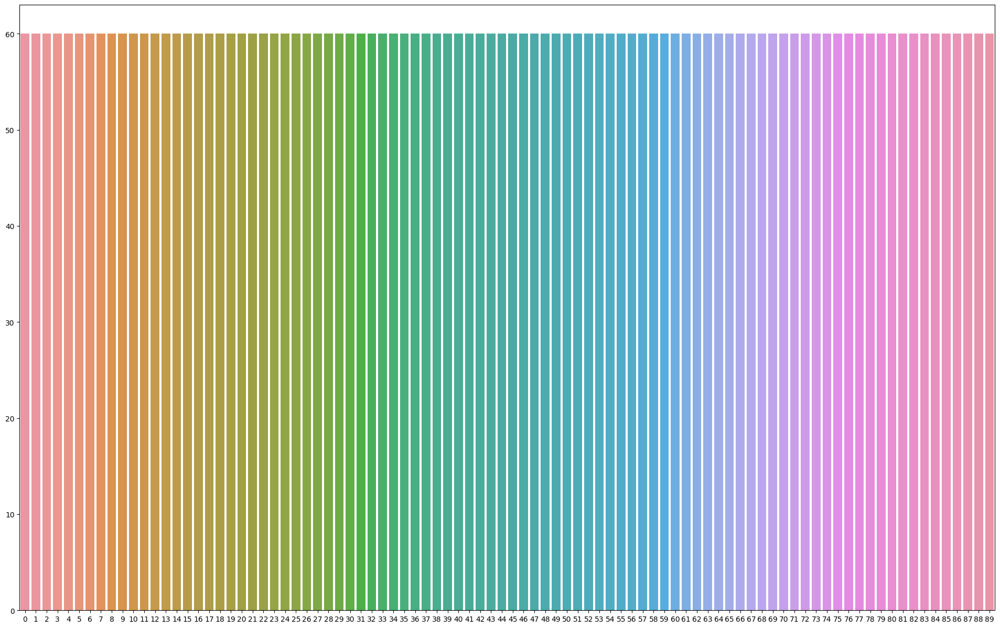

In [212]:
#Checking class-wise data distribution
fig,ax=plt.subplots(1,1,figsize=(24,15))
images={}
for i,Class in enumerate(classes):
    images_path=os.path.join(base_dir,Class)
    number_of_images=len(os.listdir(images_path))
    images[i]=number_of_images

sns.barplot(x=list(images.keys()),y=list(images.values()),ax=ax)
plt.show()
    

In [213]:
"""Since the data is equally divided among all classes, we cannot use the criteria of majority 
number of images for the selection of our 5 classes, hence now we will move on to our secondary criteria
i.e based on image dimenions and select the top 5 classes with the smallest standard deviation of aspect
ratio as then when we resize the image to a standard size these classes would be effected the least by 
the resizing"""

'Since the data is equally divided among all classes, we cannot use the criteria of majority \nnumber of images for the selection of our 5 classes, hence now we will move on to our secondary criteria\ni.e based on image dimenions and select the top 5 classes with the smallest standard deviation of aspect\nratio as then when we resize the image to a standard size these classes would be effected the least by \nthe resizing'

In [5]:
#Selects top 5 classes with the minimum aspect ratio standard deviation within the class 
class_selector=[]
for Class in classes:
    aspect_ratios=[]
    class_path=os.path.join(base_dir,Class)
    for image in os.listdir(class_path):
        img=Image.open(os.path.join(class_path,image))
        width,height=img.size
        aspect_ratio=width/height
        aspect_ratios.append(aspect_ratio)
    std_class=np.std(np.array(aspect_ratios))
    class_selector.append((Class,std_class))

class_selector=sorted(class_selector, key=lambda x:x[1])
print(class_selector[:5])
    
    
    
    

[('panda', 0.21218088074801952), ('sheep', 0.2367012864064995), ('ox', 0.2574854761143386), ('crow', 0.26239043997536676), ('coyote', 0.2711099339582745)]


In [6]:
# Our Choosen Classes

# Panda
# Sheep
# Ox
# Crow
# Coyote

In [7]:
choosen_classes=[x[0] for x in class_selector[:5]]

### Removing duplicate images

In [217]:
#Checking and removing duplicate images
""" Initially I was unaware of the presence of duplicate images in the dataset, but got to know about 
    the same while training. Removal of duplicate images is very important as it can cause the following 
    problems.
    
    1) Introduce Bias into the model
    2) Give false idea about the performance of the model.
    
    We would be using a method called average hashing for hashing our images and then identifying the 
    duplicate images by using the Hamming distance in between the hashes. 
    
"""

' Initially I was unaware of the presence of duplicate images in the dataset, but got to know about \n    the same while training. Removal of duplicate images is very important as it can cause the following \n    problems.\n    \n    1) Introduce Bias into the model\n    2) Give false idea about the performance of the model.\n    \n    We would be using a method called average hashing for hashing our images and then identifying the \n    duplicate images by using the Hamming distance in between the hashes. \n    \n'

In [218]:
#Implementing difference hashing 
def avg_hashing(image_path, hashing_size=8):
    """
    Description: This function convert an image into a binary string based on if the pixel value is greater
    or smaller than the average pixel value
    
    Input: Image path, hashing_size
    
    Output: Image bits 
    
    """ 
    img=cv.imread(image_path)
    
    resized_image= cv.resize(img,(hashing_size,hashing_size))
    
    grayscale = cv.cvtColor(resized_image, cv.COLOR_BGR2GRAY)  # Convert to grayscale
    
    avg_pixel = np.mean(grayscale) #get average pixel value 
    
    bits = "".join(map(lambda pixel: '1' if pixel < avg_pixel else '0', grayscale.flatten()))
    
    return int(bits, 2)

In [219]:
#Calculating the hamming distance
def hamming_distance(hash1, hash2):
    """
    Description: Calculates the hamming distance inbetween our hashes
    
    Input: Hash1 and Hash2
    
    Output: Hamming distance between the hashes
    """
    return bin(hash1 ^ hash2).count('1')

In [220]:
#Getting the similar images 

threshold=7 #threshold value for hamming distance for similarity measurement 
duplicates = {}
hash_container = {}

for Class in choosen_classes:
    class_path=os.path.join(base_dir, Class)
    duplicates[Class]=[]
    for image in os.listdir(class_path):
        image_path=os.path.join(class_path, image)
        image_hash_val = avg_hashing(image_path)
        similar_image = None

        for hash_val, path in hash_container.items():
            if hamming_distance(hash_val, image_hash_val) < threshold:
                similar_image = path
                break

        if similar_image:
            duplicates[Class].append((image_path, similar_image))
        else:
            hash_container[image_hash_val] = image_path

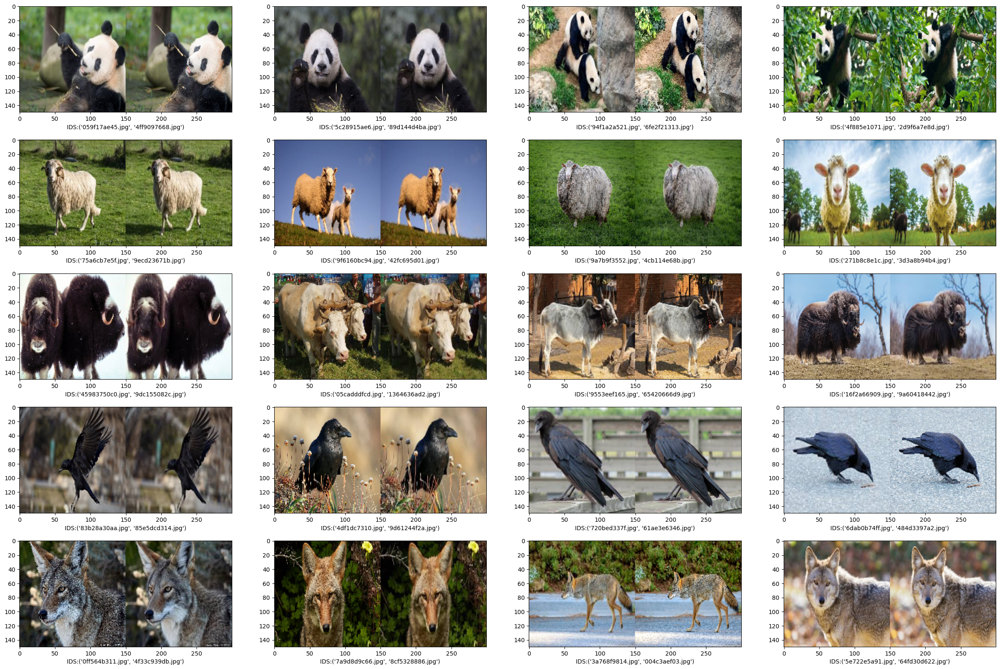

In [221]:
#Visualing similar images

fig, ax= plt.subplots(5, 4, figsize=(30,20))
for i, Class in enumerate(choosen_classes):
    for j, similar_images in enumerate(duplicates[Class][:4]):
        img1=cv.imread(similar_images[0])
        img2=cv.imread(similar_images[1])
        
        img1=cv.cvtColor(img1, cv.COLOR_BGR2RGB)
        img2=cv.cvtColor(img2, cv.COLOR_BGR2RGB)
        
        img1=cv.resize(img1, (150,150))
        img2=cv.resize(img2, (150,150))
        
        stacked=np.hstack((np.array(img1),np.array(img2)))
        
        img1_name=os.path.basename(similar_images[0])
        img2_name=os.path.basename(similar_images[1])
        
        ax[i][j].imshow(stacked)
        ax[i][j].set_xlabel(f"IDS:{(img1_name,img2_name)}")
        

In [222]:
"""
Note: To not affect the original dataset we will deal with these duplicate images when create our dataset
and delete them now.

"""

'\nNote: To not affect the original dataset we will deal with these duplicate images when create our dataset\nand delete them now.\n\n'

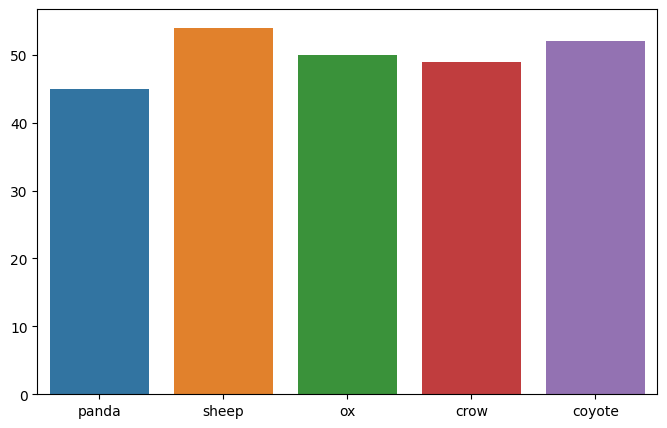

In [223]:
#Data distribution after removal of duplicate images 

fig, ax= plt.subplots(1, 1, figsize=(8,5))
duplicates_container={}
images={}
for i, Class in enumerate(choosen_classes):
    container=[]
    for j, similar_images in enumerate(duplicates[Class]):
        container.append(os.path.basename(similar_images[1]))
    duplicates_container[Class]=container
    images_path=os.path.join(base_dir,Class)
    number_of_images=len(os.listdir(images_path))- len(container)
    images[Class]=number_of_images
    
sns.barplot(x=list(images.keys()),y=list(images.values()),ax=ax)
plt.show()
        

In [224]:
print(duplicates_container)

{'panda': ['4ff9097668.jpg', '89d144d4ba.jpg', '6fe2f21313.jpg', '2d9f6a7e8d.jpg', '4c3a1621ce.jpg', '26fe3f4c73.jpg', '2e7b2b1899.jpg', '8fc061f4d8.jpg', '496bd52415.jpg', '6c5d1f2251.jpg', '9af77fbae5.jpg', '09ec7468db.jpg', '8ae67d1a1a.jpg', '2e5ecf80c3.jpg', '309a27763a.jpg'], 'sheep': ['9ecd23671b.jpg', '42fc695d01.jpg', '4cb114e68b.jpg', '3d3a8b94b4.jpg', '9ad32bfac2.jpg', '7a0ea10a70.jpg'], 'ox': ['9dc155082c.jpg', '1364636ad2.jpg', '65420666d9.jpg', '9a60418442.jpg', '68dd78fab4.jpg', '684b18044c.jpg', '216b3f0751.jpg', '73ebe70d39.jpg', '6014098a12.jpg', '221f1df65e.jpg'], 'crow': ['85e5dcd314.jpg', '9d61244f2a.jpg', '61ae3e6346.jpg', '484d3397a2.jpg', '3bc2b28fdd.jpg', '0cfbaa338f.jpg', '1d586ca67a.jpg', '8b94b5d529.jpg', '94be0c5a37.jpg', '09cf92f743.jpg', '2caed0387c.jpg'], 'coyote': ['4f33c939db.jpg', '8cf5328886.jpg', '004c3aef03.jpg', '64fd30d622.jpg', '9cefc03068.jpg', '42ce2a0e8c.jpg', '39ec92a6f7.jpg', '98f084e404.jpg']}


In [19]:
"""Since the dataset does not contain a separate train and test folder we need to create a new dataset from
the original dataset with train and test data and only consisting of our 5 classes. We do this step before 
starting to work with the data to prevent any kind of data leakage"""

'Since the dataset does not contain a separate train and test folder we need to create a new dataset from\nthe original dataset with train and test data and only consisting of our 5 classes. We do this step before \nstarting to work with the data to prevent any kind of data leakage'

In [8]:
#Assigning base directories path

new_base_dir=r"/kaggle/input/gandhinagar-dataset/Dataset"
five_class=os.path.join(new_base_dir,"5-Class-Classification")

In [9]:
# Assigning train and test directories path

train_dir=os.path.join(five_class,"train")
test_dir=os.path.join(five_class,"test")

In [228]:
#Creating the directories

if os.path.exists(new_base_dir)==False:
    os.mkdir(new_base_dir)

if os.path.exists(five_class)==False:
    os.mkdir(five_class)  

if os.path.exists(train_dir)==False:
    os.mkdir(train_dir)
    
if os.path.exists(test_dir)==False:
    os.mkdir(test_dir)

In [229]:
#Getting Train and Test Images

test_size=0.2 # Defines the size of the test dataset
test_images_paths=[]
train_images_paths=[]

for Class in choosen_classes:
    class_path=os.path.join(base_dir, Class)
    class_size=len(os.listdir(class_path))- len(duplicates_container[Class]) #Getting number of images after removal of duplicates

    test_paths=[]
    train_paths=[]
    
    i=0
    for image in os.listdir(class_path):
        
        if image in duplicates_container[Class]:continue # Stopping addition of duplicate images
        if i+1<=test_size*class_size:test_paths.append(image)
        else:train_paths.append(image)
        i+=1
    test_images_paths.append((Class, test_paths))
    train_images_paths.append((Class, train_paths))

In [230]:
def move_images(img_names, source_dir, destination_dir):
    """ 
        Description: Function to transfer images from source to destination directory
    
        Input: Image names, source directory and destination directory
        
        output: Copied images from source to destination directory
    
    """
    
    for Class,images in img_names:
        class_source=os.path.join(source_dir,Class)
        class_destination=os.path.join(destination_dir,Class)

        if os.path.exists(class_destination)==False:os.mkdir(class_destination)

        for image in images:
            source_img_path=os.path.join(class_source,image)
            destination_img_path=os.path.join(class_destination,image)
            shutil.copy(source_img_path, destination_img_path)

In [ ]:
#Moving Images from original directory to new train and test set

#For training images directory
move_images(train_images_paths,source_dir=base_dir, destination_dir=train_dir)


#For testing images directory 
move_images(test_images_paths,source_dir=base_dir, destination_dir=test_dir)

In [10]:
#Visualizing the new directory structure

def list_files(startpath):
    """
    Description : Function to display file structure
    
    Input : Starting path
    
    Output: File structure
    """
    for root, dirs, files in os.walk(startpath):
        level = root.replace(startpath, '').count(os.sep)
        indent = ' ' * 4 * (level)
        print('{}{}/'.format(indent, os.path.basename(root)))
        subindent = ' ' * 4 * (level + 1)



In [11]:
list_files(five_class)

5-Class-Classification/
    test/
        coyote/
        crow/
        sheep/
        ox/
        panda/
    train/
        coyote/
        crow/
        sheep/
        ox/
        panda/


### One Vs Rest

In [ ]:
"""Now that our 5 classes dataset is ready we can start working on our One Vs Rest problem, to do so we first begin by creating
   our one vs rest dataset for each indivisual class"""

### Creating One Vs Rest Dataset

In [234]:
ovr_dir=os.path.join(new_base_dir,"OVR")
if os.path.exists(ovr_dir)==False:
        os.mkdir(ovr_dir)

In [ ]:
"""
   To generate the One Vs Rest dataset we need to generate 5 different datasets each for each class we want to predict.
   In the dataset for each class we need a positive sub class denoting the class and a negative sub class denoting anyother 
   class.  
   
   Eg: For Class "Panda": Positive Class = Panda, Negative Class=[Sheep, Crow, Ox, Coyote]

"""

#Getting the images for the positive and the negative sub classes for each individual class
positive_images=[]
negative_images=[]

for positive_class in choosen_classes:
   
    temp=[]
    class_path=os.path.join(ovr_dir,positive_class)
    positive=os.path.join(class_path,"positive")
    negative=os.path.join(class_path,"negative")
        
    if os.path.exists(class_path)==False:
        os.mkdir(class_path)
        
    if os.path.exists(positive)==False:
        os.mkdir(positive)
        
    if os.path.exists(negative)==False:
        os.mkdir(negative)
    
    source_dir=os.path.join(train_dir, positive_class)
    positive_images.append((positive_class, os.listdir(source_dir)))
    
    for Class in choosen_classes:
        original_path=os.path.join(train_dir,Class)
        
        if Class==positive_class:continue
        temp.append((Class,os.listdir(original_path)))
        
    negative_images.append((positive_class, temp))
    

In [ ]:
#Moving the images to the respective folders 

i=0
for Class, images in positive_images:
   
    class_path_destination=os.path.join(ovr_dir, Class)
    class_path_source=os.path.join(train_dir, Class) 
    
    positive_path=os.path.join(class_path_destination, "positive")
    negative_path=os.path.join(class_path_destination, "negative")

    for image in images:
        source=os.path.join(class_path_source,image)
        destination=os.path.join(positive_path, image)
        shutil.copy(source, destination)
    
    for negative_class, negatives in negative_images[i][1]:
        negative_class_path=os.path.join(train_dir,negative_class)
        for image in negatives:
            source=os.path.join(negative_class_path,image)
            destination=os.path.join(negative_path, image)
            shutil.copy(source, destination)
            
    i+=1                

In [ ]:
#One Vs Rest Data Structure

list_files(ovr_dir)

### Setting up data generator and creating the model function 

In [ ]:
tf.test.is_gpu_available()

In [ ]:
len(tf.config.list_physical_devices('GPU'))

In [ ]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)


In [ ]:
""" Before starting with the model building process, we need to decide the fixed size parameter. Lets start by plotting the
    distribution of the aspect ratios"""

In [ ]:
#Plotting the aspect ratio distribution for the positive and negative images of each class, to decide an approporate aspect ratio


fig, ax= plt.subplots(5, 2, figsize=(15,30))
colors = sns.color_palette("Set2", 6)
pos_mean_avg=0
pos_median_avg=0

neg_mean_avg=0
neg_median_avg=0

for i, Class in enumerate(choosen_classes):
    positive_aspect_ratios=[]
    negative_aspect_ratios=[]
    
    class_path=os.path.join(ovr_dir,Class)
    positive_path=os.path.join(class_path, "positive")
    negative_path=os.path.join(class_path, "negative")
    
    for pos_img in os.listdir(positive_path):
      
        img=Image.open(os.path.join(positive_path,pos_img))
        width,height=img.size
        pos_aspect_ratio=width/height
        positive_aspect_ratios.append(pos_aspect_ratio)
    pos_std_dev=np.std(np.array(aspect_ratios))
    
    for neg_img in os.listdir(negative_path):
        img=Image.open(os.path.join(negative_path,neg_img))
        width,height=img.size
        neg_aspect_ratio=width/height
        negative_aspect_ratios.append(neg_aspect_ratio)
    neg_std_dev=np.std(np.array(aspect_ratios))
    
    sns.histplot(positive_aspect_ratios, kde=True, ax=ax[i][0], color=colors[i])
    sns.histplot(negative_aspect_ratios, kde=True, ax=ax[i][1], color=colors[i])
    
    ax[i][0].set_xlabel(f"{Class}(Mean:{round(np.mean(positive_aspect_ratios),2)},Median:{round(np.median(positive_aspect_ratios),2)}):Positive Aspect Ratio")
    ax[i][1].set_xlabel(f"{Class}(Mean:{round(np.mean(negative_aspect_ratios),2)},Median:{round(np.median(negative_aspect_ratios),2)}):Negative Aspect Ratio")
    
    pos_mean_avg+=round(np.mean(positive_aspect_ratios),2)
    pos_median_avg+=round(np.median(positive_aspect_ratios),2)

    neg_mean_avg+=round(np.mean(negative_aspect_ratios),2)
    neg_median_avg+=round(np.median(negative_aspect_ratios),2)



In [ ]:
print(f"Positive mean average:{pos_mean_avg/5}")
print(f"Positive median average:{pos_median_avg/5}")
print(f"Negative median average:{neg_mean_avg/5}")
print(f"Negative median average:{neg_median_avg/5}")

In [ ]:
"""Hence an aspect ratio of 1.5 seems good"""

In [12]:
#We will keep a max dimension of 256

img_width_resized=int(256.0)
img_height_resized=int(img_width_resized//1.5)
batch_size=32

print(f"Image width:{img_width_resized}")
print(f"Image height:{img_height_resized}")

Image width:256
Image height:170


In [17]:
#Setting up data generators

def data_generator(dataframe,x_col, y_col, directory,target_size=(256,256),batch_size=32,classes=None,
                   class_mode="categorical",color_mode="rgb",validation_split=0.0,augmentation=False,augmentation_params=None):
    """
        Data generators are very useful for training deep learning models, they offer the follwoing advantages
    
        1) Efficient Memory Usage
        2) Dynamic data loading capability 
        3) Easy data augmentation options
    
        We will use the Keras library here to create our image data generators
        
        Major Inputs: dataframe, training features names->x_col, labels->y_col
        
        Output : data generator
    
    """
    
    if augmentation == True:
        if augmentation_params==None:raise ValueError("Non parameters passed")
        img_data_generator=tf.keras.preprocessing.image.ImageDataGenerator(augmentation_params,rescale=1/255.0, validation_split=validation_split)
        
    else:
        img_data_generator=tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255.0, validation_split=validation_split)
    
    train_datagenerator=img_data_generator.flow_from_dataframe(
        dataframe=dataframe,
        directory=directory,
        x_col=x_col,
        y_col=y_col,
        target_size=target_size,
        class_mode=class_mode,
        classes=classes,
        subset="training",
        color_mode=color_mode,
        keep_aspect_ratio=False,
        shuffle=False
    )
    
    valid_datagenerator=img_data_generator.flow_from_dataframe(
        dataframe=dataframe,
        directory=directory,
        x_col=x_col,
        y_col=y_col,
        target_size=target_size,
        batch_size=batch_size,
        class_mode=class_mode,
        classes=classes,
        subset="validation",
        color_mode=color_mode,
        keep_aspect_ratio=False,
        Shuffle=False
    )
    
    if validation_split>0.0:
        return train_datagenerator, valid_datagenerator
    else:
        return train_datagenerator

### Model Building

In [14]:
"""
With the data generators ready, now we can begin our model building process, we will use the tensorflow functional API to build 
our model giving us more control rather than a sequential approach.
"""

'\nWith the data generators ready, now we can begin our model building process, we will use the tensorflow functional API to build \nour model giving us more control rather than a sequential approach.\n'

In [15]:
input_shape=(img_width_resized,img_height_resized,1)

In [238]:
def base_model():
    """
    Description: Base model for the One Vs Rest multi classification
    
    Input: NONE
    
    Output: Model
    
    """
    inputs=tf.keras.Input(input_shape)
    x=tf.keras.layers.Conv2D(filters=128,kernel_size=(3,3),strides=(1,1),activation="relu")(inputs)
    x=tf.keras.layers.Conv2D(filters=128,kernel_size=(3,3),strides=(1,1),activation="relu")(x)
    x=tf.keras.layers.MaxPooling2D((3,3),strides=2)(x)
    
    x=tf.keras.layers.Conv2D(filters=64,kernel_size=(3,3),strides=(1,1),activation="relu")(x)
    x=tf.keras.layers.Conv2D(filters=64,kernel_size=(3,3),strides=(1,1),activation="relu")(x)
    x=tf.keras.layers.MaxPooling2D((3,3),strides=2)(x)
    
    
    x=tf.keras.layers.Conv2D(filters=32,kernel_size=(3,3),strides=(1,1),activation="relu")(x)
    x=tf.keras.layers.MaxPooling2D((3,3),strides=2)(x)
    x=tf.keras.layers.Conv2D(filters=32,kernel_size=(3,3),strides=(1,1),activation="relu")(x)
    x=tf.keras.layers.MaxPooling2D((3,3),strides=2)(x)
  
    
    
    x=tf.keras.layers.Conv2D(filters=16,kernel_size=(3,3),strides=(1,1),activation="relu")(x)
    x=tf.keras.layers.MaxPooling2D((3,3),strides=2)(x)
    x=tf.keras.layers.Dropout(0.2)(x)
    
    x=tf.keras.layers.Flatten()(x)
    x=tf.keras.layers.Dense(60,activation="relu")(x)
    x=tf.keras.layers.Dense(30,activation="relu")(x)
    x=tf.keras.layers.Dense(1,activation="sigmoid")(x)
    
    return tf.keras.Model(inputs=inputs,outputs=x)

In [239]:
model=base_model()
model.summary()

Model: "model_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_16 (InputLayer)       [(None, 256, 170, 1)]     0         
                                                                 
 conv2d_70 (Conv2D)          (None, 254, 168, 128)     1280      
                                                                 
 conv2d_71 (Conv2D)          (None, 252, 166, 128)     147584    
                                                                 
 max_pooling2d_50 (MaxPooli  (None, 125, 82, 128)      0         
 ng2D)                                                           
                                                                 
 conv2d_72 (Conv2D)          (None, 123, 80, 64)       73792     
                                                                 
 conv2d_73 (Conv2D)          (None, 121, 78, 64)       36928     
                                                          

### Model Optimization using Stratfied K-Fold

In [318]:
"""
    Before we begin setting up the Kfold CV, I want to use the F1-Score as the evaluation metric for the OVR Classification 
    mainly due to the large data imbalance between the positive and the negative classes for each individual class, but to do 
    so we will need to find an optimum threshold to convert our probabilities into absolute values to calculate the F1 Score.
    
"""

'\n    Before we begin setting up the Kfold CV, I want to use the F1-Score as the evaluation metric for the OVR Classification \n    mainly due to the large data imbalance between the positive and the negative classes for each individual class, but to do \n    so we will need to find an optimum threshold to convert our probabilities into absolute values to calculate the F1 Score.\n    \n'

In [10]:
#Defining number of folds
k_fold=3

In [11]:
#Getting Optimal F1-Score Threshold

In [321]:
def get_optimal_threshold(y_true, y_pred):
    thresholds=[threshold/100 for threshold in range(10, 101, 5)]
    f1_scores=[]
    Max=0
    max_thresh=0
    for threshold in thresholds:
        y_pred_thresh=[1 if y>threshold else 0 for y in y_pred]
        F1_score=f1_score(y_true, y_pred_thresh,average='macro')
        
        if F1_score>Max:
            Max=F1_score
            max_thresh=threshold
        f1_scores.append(F1_score)
    print(f"Maximum f1-score attained at threshold:{max_thresh}")
    print(f"Maximum f1-score:{round(Max,2)}")
    return thresholds, f1_scores, max_thresh
    

In [322]:
#Implementing 3-Fold Stratified Cross Validation
def kfold_training(dataframe, directory, x_col_name, y_col_name, callbacks,augmentation=False, augmentation_params=None):
    Skfold=StratifiedKFold(n_splits=3,shuffle=True,random_state=42)
    x_col=np.array(dataframe[x_col_name])
    y_col=np.array(dataframe[y_col_name])
    
    f1_scores_thresholds_max=[]
    histories=[]
    
    j=0
    for train_index, test_index in Skfold.split(x_col, y_col):
        print(f"Split:{j}")
        
        train_df=dataframe.iloc[train_index]
        test_df=dataframe.iloc[test_index]
        
        train_generator=data_generator(directory=directory,x_col=x_col_name,y_col=y_col_name,dataframe=train_df,
                        target_size=(img_width_resized,img_height_resized), classes=None,class_mode="binary",
                        color_mode="grayscale", augmentation=augmentation, augmentation_params=augmentation_params)
        
        test_generator=data_generator(directory=directory,x_col=x_col_name,y_col=y_col_name,dataframe=test_df,
                        target_size=(img_width_resized,img_height_resized), classes=None,class_mode="binary",
                        color_mode="grayscale")
        
        model=base_model()
        model.compile(optimizer="adam", loss=tf.keras.losses.BinaryCrossentropy())
        history=model.fit(train_generator, epochs=20,validation_data=test_generator,batch_size=batch_size,verbose=2,callbacks=callbacks)
        
        y_pred=model.predict(test_generator)
        
        number_of_examples = len(test_generator.filenames)
        number_of_generator_iterations = math.ceil(number_of_examples / (1.0 * batch_size)) 
        
        y_true = []

        for i in range(0,int(number_of_generator_iterations)):
            y_true.extend(np.array(test_generator[i][1]))
        
        thresholds, f1_scores, max_thresh=get_optimal_threshold(y_true, y_pred)
        y_pred_thresh=[1 if y>max_thresh else 0 for y in y_pred]
        
        if j==0:
            incorrect_images=[(files, y_true[i], y_pred_thresh[i]) for i,files in enumerate(test_generator.filenames) if y_true[i]!=y_pred_thresh[i]]
            correct_images=[(files, y_true[i], y_pred_thresh[i]) for i,files in enumerate(test_generator.filenames) if y_true[i]==y_pred_thresh[i]]
            
        
        f1_scores_thresholds_max.append([f1_scores,thresholds, max_thresh])
        histories.append(history)
            
        j+=1
        
    return f1_scores_thresholds_max, incorrect_images, correct_images, histories

In [39]:
def scheduler(epoch,lr):
    if epoch<5 or lr<0.0006:
        return lr
    elif lr>0.0006:
        return lr*np.exp(-0.1)

In [324]:
learning_rate_scheduler=tf.keras.callbacks.LearningRateScheduler(schedule=scheduler,verbose=0)
early_stopping=tf.keras.callbacks.EarlyStopping(
    monitor="val_loss",
    min_delta=0,
    patience=20,
    verbose=0,
    mode="min",
    baseline=None,
    restore_best_weights=True,
    start_from_epoch=0,
)

callbacks=[early_stopping,learning_rate_scheduler]

In [ ]:
#Optimizing model using Stratified-3 Fold Cross Validation
dataframe=[]

all_class_f1_scores_thresholds_max=[]
all_incorrect_images=[]
all_correct_images=[]
all_histories=[]

augmentation_params={
    "horizontal_flip":True,
    "vertical_flip":True,
    "zoom_range":0.12,
    "fill_mode":"reflect"
}

for Class in choosen_classes:
    print(f"Training Class:{Class}")
    class_f1_scores_thresholds_max=None
    labels=[]
    img_paths=[]
    
    class_path=os.path.join(ovr_dir, Class)
    positive_path=os.path.join(class_path, "positive")
    negative_path=os.path.join(class_path, "negative")
    
    for img in os.listdir(positive_path):
        img_path=os.path.join(positive_path,img)
        img_paths.append(img_path)
        labels.append("positive")
    
    for img in os.listdir(negative_path):
        img_path=os.path.join(negative_path,img)
        img_paths.append(img_path)
        labels.append("negative")
        
    dataframe=pd.DataFrame(img_paths, columns=["image_paths"])
    dataframe["labels"]=labels
    dataframe = dataframe.sample(frac = 1)
    class_f1_scores_thresholds_max,incorrect_images, correct_images, histories=kfold_training(dataframe=dataframe, 
                                                     directory=class_path, x_col_name="image_paths", 
                                                     y_col_name="labels", callbacks=callbacks)
    
    all_correct_images.append((Class,correct_images))
    all_incorrect_images.append((Class,incorrect_images))
    all_histories.append(histories)
    all_class_f1_scores_thresholds_max.append(class_f1_scores_thresholds_max)
   

In [ ]:
"""
Model Log
--------------------------------------------------------------------------------------------------------
Loss function: Binary Cross Entropy

Cross Validation method: Stratified-K Fold , K=3

Epochs: 20

Callbacks: Early Stopping to prevent overfitting
           Learning Rate Scheduler as the model would often overshoot from the middle phase

Data Augmentation: Tried but didn't provide much benefit.

Overfiiting: Major overfitting addressed through careful layer selection, hyperpaprameter optimization
             and regularization.
           
"""

### Visualizing results of cross-validation

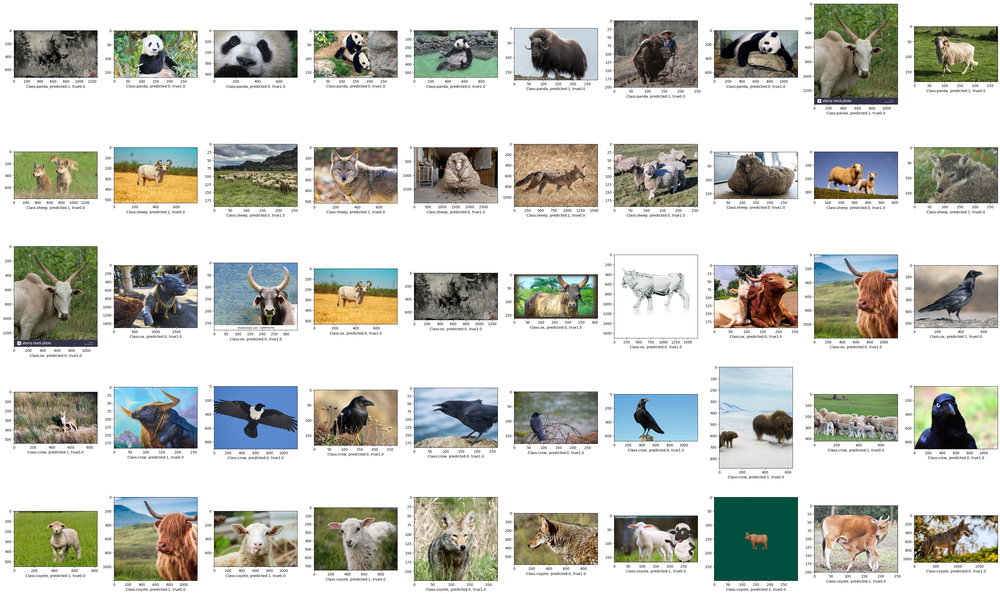

In [328]:
#Some of the wrongly classified images for each class

fig,ax=plt.subplots(5,10, figsize=(50,30))
for i,incorrect_images in enumerate(all_incorrect_images):
    for j, values in enumerate(incorrect_images[1][:10]):
        image, y_true, y_pred= values
        img=Image.open(image)
        ax[i][j].imshow(img)
        ax[i][j].set_xlabel(f"Class:{incorrect_images[0]}, predicted:{y_pred}, true{y_true}")
plt.show()
        
    

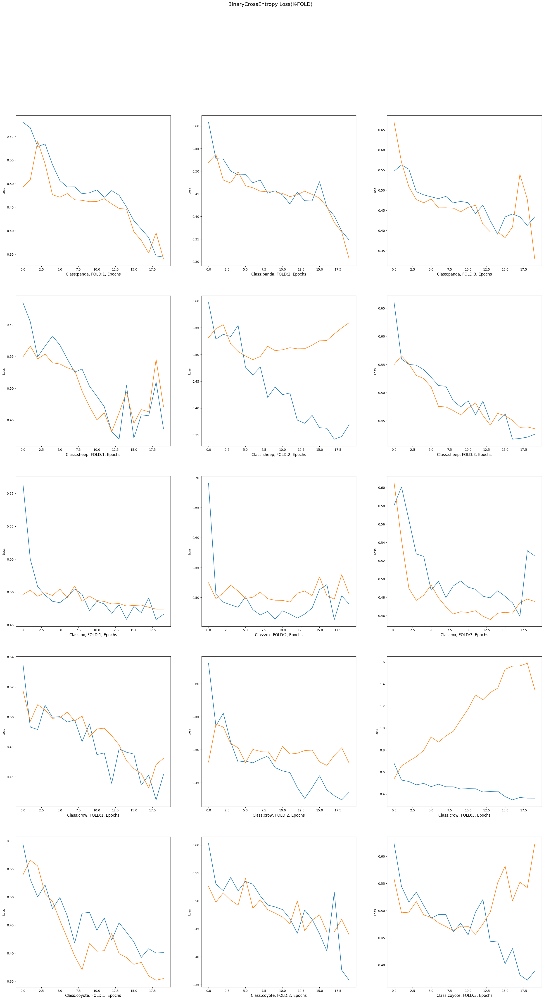

In [329]:
#Plotting the loss for each fold
fig,ax=plt.subplots(5,3, figsize=(30, 50))
for i, Class in enumerate(choosen_classes):
    for j in range(k_fold):
        history=all_histories[i][j]
        ax[i][j].plot(np.arange(20),history.history["loss"])
        ax[i][j].plot(np.arange(20),history.history["val_loss"])
        ax[i][j].set_xlabel(f"Class:{Class}, FOLD:{j+1}, Epochs", fontsize=12)
        ax[i][j].set_ylabel("Loss")
    fig.suptitle("BinaryCrossEntropy Loss(K-FOLD)", fontsize=16)
plt.show()

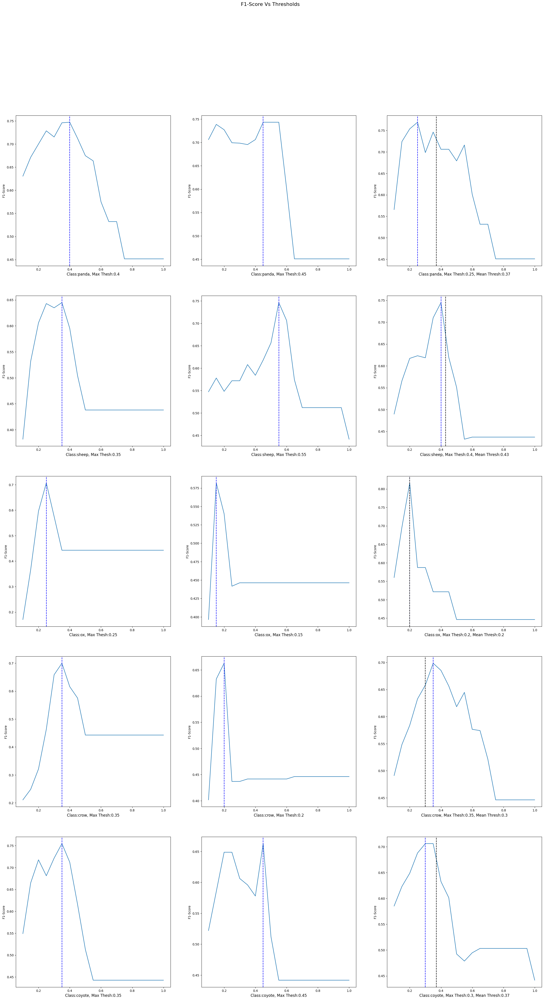

In [330]:
fig,ax=plt.subplots(5,3, figsize=(30, 50))
mean_thresholds={}
for i, Class in enumerate(choosen_classes):
    thresh_sum=0
    for j in range(k_fold):
        f1_scores_thresholds_max=all_class_f1_scores_thresholds_max[i][j]
        f1_scores, thresholds, max_thresh=f1_scores_thresholds_max
        thresh_sum+=max_thresh
        
        ax[i][j].plot(thresholds, f1_scores)
        ax[i][j].axvline(x=max_thresh, color='b', linestyle='--')
        
        if j==k_fold-1:
            avg_thresh=thresh_sum/k_fold
            ax[i][j].axvline(x=round(avg_thresh,2), color='black', linestyle='--')
            ax[i][j].set_xlabel(f"Class:{Class}, Max Thesh:{max_thresh}, Mean Thresh:{round(avg_thresh,2)}", fontsize=12)
            mean_thresholds[Class]=avg_thresh
            
        else:
            ax[i][j].set_xlabel(f"Class:{Class}, Max Thesh:{max_thresh}", fontsize=12)
            
        ax[i][j].set_ylabel("F1-Score")
    fig.suptitle("F1-Score Vs Thresholds", fontsize=16)
plt.show()

In [ ]:
#Final Thresholds
thresholds={
    "panda":0.37,
    "sheep":0.43,
    "ox":0.2,
    "crow":0.3,
    "coyote":0.37
}

### Building Final OVR Model

In [ ]:
"""
Now that our base model is optimized we can train the model for each individual class on the whole 
dataset and make our final predictor.

"""

In [364]:
#Trainging Parameters
Epochs=30
Optimizer="adam"
Loss=tf.keras.losses.BinaryCrossentropy()

In [367]:
#Assigning Callbacks
learning_rate_scheduler=tf.keras.callbacks.LearningRateScheduler(schedule=scheduler,verbose=0)
early_stopping=tf.keras.callbacks.EarlyStopping(
    monitor="val_loss",
    min_delta=0,
    patience=20,
    verbose=0,
    mode="min",
    baseline=None,
    restore_best_weights=True,
    start_from_epoch=0,
)

callbacks=[early_stopping,learning_rate_scheduler]

In [ ]:
histories=[]
models=[]
for Class in choosen_classes:
    labels=[]
    img_paths=[]
    class_callbacks=[]
    class_path=os.path.join(ovr_dir, Class)
    positive_path=os.path.join(class_path, "positive")
    negative_path=os.path.join(class_path, "negative")
    
    for img in os.listdir(positive_path):
        img_path=os.path.join(positive_path,img)
        img_paths.append(img_path)
        labels.append("positive")
    
    for img in os.listdir(negative_path):
        img_path=os.path.join(negative_path,img)
        img_paths.append(img_path)
        labels.append("negative")
        
    dataframe=pd.DataFrame(img_paths, columns=["image_paths"])
    dataframe["labels"]=labels
    dataframe = dataframe.sample(frac = 1)
    
    Data_Generator=data_generator(directory=class_path,x_col="image_paths",y_col="labels",dataframe=dataframe,
                        target_size=(img_width_resized,img_height_resized), classes=None,class_mode="binary",
                        color_mode="grayscale")
    
    model=base_model()
    model.compile(optimizer=Optimizer, loss=Loss)
    history=model.fit(Data_Generator, epochs=Epochs,batch_size=batch_size,verbose=2,callbacks=callbacks)
    
    models.append(model)
    histories.append(history)
    
    

In [369]:
for model, Class in zip(models,choosen_classes):
    filename=f"/kaggle/working/checkpoint_{Class}.h5"
    model.save_weights(filename)

In [370]:
#Combining Model
def OVR_MODEL(Input):
    """
    Description: Model to combine the 5 seperate models into a single model
    
    Input: Image generator
    
    Output: OVR Model predictions
    """
    outputs=[]
    i=0
    for Class in choosen_classes:
        weights_file=f"/kaggle/working/checkpoint_{Class}.h5"
        model.load_weights(weights_file)
        model.compile(optimizer=Optimizer, loss=Loss)
        output=model.predict(Input)
        outputs.append(output)
        
        i+=1
   
    per_img_output=[]
    for i in range(len(Input.filenames)):
        output=[]
        for j in range(len(choosen_classes)):
            output.append(outputs[j][i])
        per_img_output.append(output)
    
    return per_img_output
        


### Testing on test set 

In [371]:
test_dir="/kaggle/input/gandhinagar-dataset/Dataset/5-Class-Classification/test"

In [377]:
histories=[]
labels=[]
img_paths=[]
for Class in choosen_classes:
    class_callbacks=[]
    class_path=os.path.join(test_dir, Class)

    
    for image in os.listdir(class_path):
        image_path=os.path.join(class_path, image)
        img_paths.append(image_path)
        labels.append(Class)
    
dataframe=pd.DataFrame(img_paths, columns=["image_paths"])
dataframe["labels"]=labels
dataframe = dataframe.sample(frac = 1)
    
Data_Generator=data_generator(directory=class_path,x_col="image_paths",y_col="labels",dataframe=dataframe,
                        target_size=(img_width_resized,img_height_resized), classes=choosen_classes,class_mode="categorical",
                        color_mode="grayscale")

outputs=OVR_MODEL(Data_Generator)

y_pred=np.argmax(np.array(outputs), axis=1)
y_true=Data_Generator.labels

F1_SCORE=f1_score(y_true, y_pred, average="micro")
print(f"Test F1-SCORE:{round(F1_SCORE,4)}")

Found 48 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.
2/2 [==============================] - 0s 80ms/step
Test F1-SCORE:0.5417


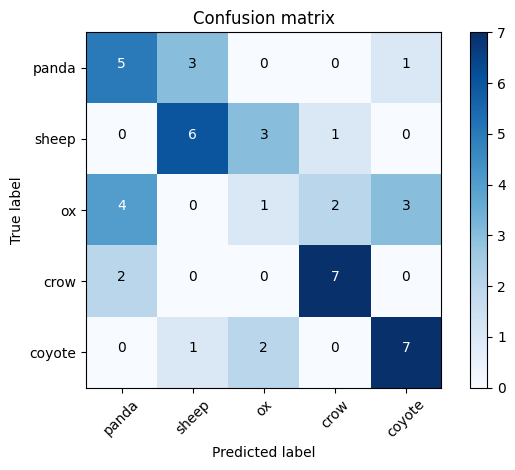

In [374]:
#Confusion Matrix
cm=confusion_matrix(y_true, y_pred)

# Plot confusion matrix
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion matrix')
plt.colorbar()

classes = choosen_classes
tick_marks = np.arange(len(classes))

plt.xticks(tick_marks, classes, rotation=45)
plt.yticks(tick_marks, classes)

plt.ylabel('True label')
plt.xlabel('Predicted label')

# Print the confusion matrix values
for i in range(len(classes)):
    for j in range(len(classes)):
        plt.text(j, i, cm[i, j], horizontalalignment='center', color='white' if cm[i, j] > cm.max() / 2 else 'black')

plt.tight_layout()
plt.show()


### Visualizing Layer Activations 

/kaggle/input/gandhinagar-dataset/Dataset/5-Class-Classification/train/panda/4ff9097668.jpg
Found 1 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.
1/1 [==============================] - 0s 71ms/step


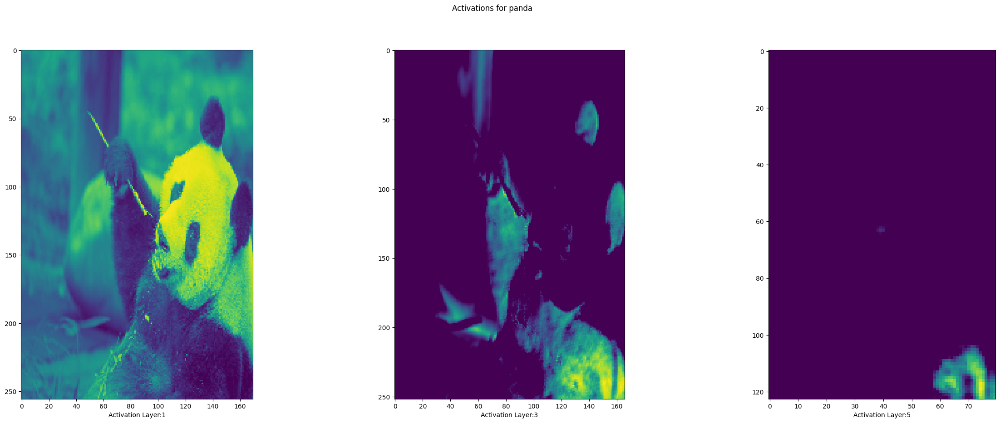

/kaggle/input/gandhinagar-dataset/Dataset/5-Class-Classification/train/sheep/94cc221de3.jpg
Found 1 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.
1/1 [==============================] - 0s 69ms/step


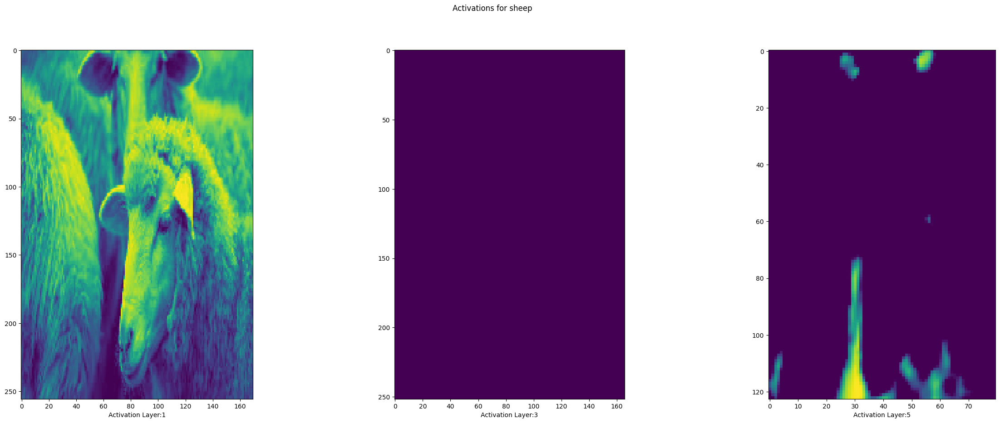

/kaggle/input/gandhinagar-dataset/Dataset/5-Class-Classification/train/ox/9635c8c313.jpg
Found 1 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.
1/1 [==============================] - 0s 81ms/step


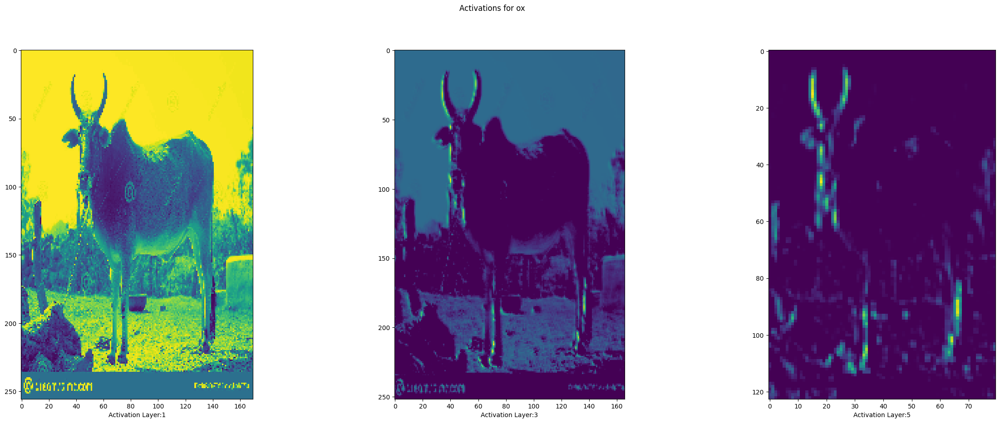

/kaggle/input/gandhinagar-dataset/Dataset/5-Class-Classification/train/crow/85e5dcd314.jpg
Found 1 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.
1/1 [==============================] - 0s 72ms/step


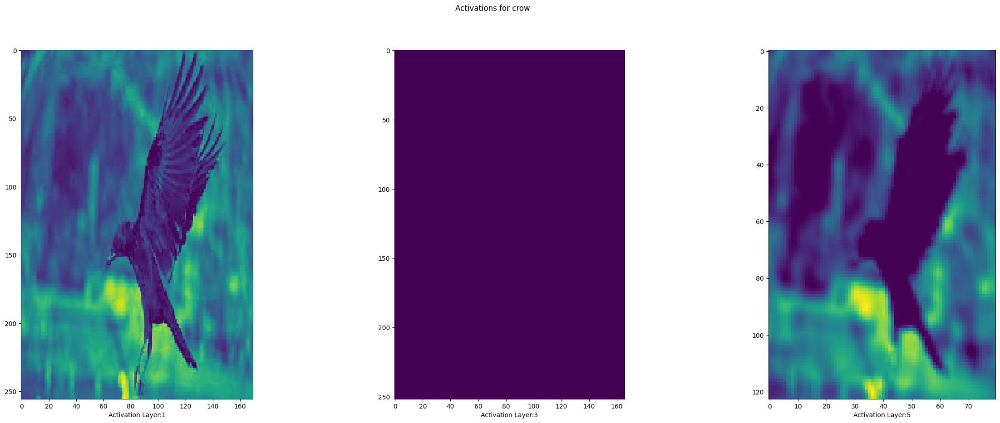

/kaggle/input/gandhinagar-dataset/Dataset/5-Class-Classification/train/coyote/23dcefd769.jpg
Found 1 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.
1/1 [==============================] - 0s 66ms/step


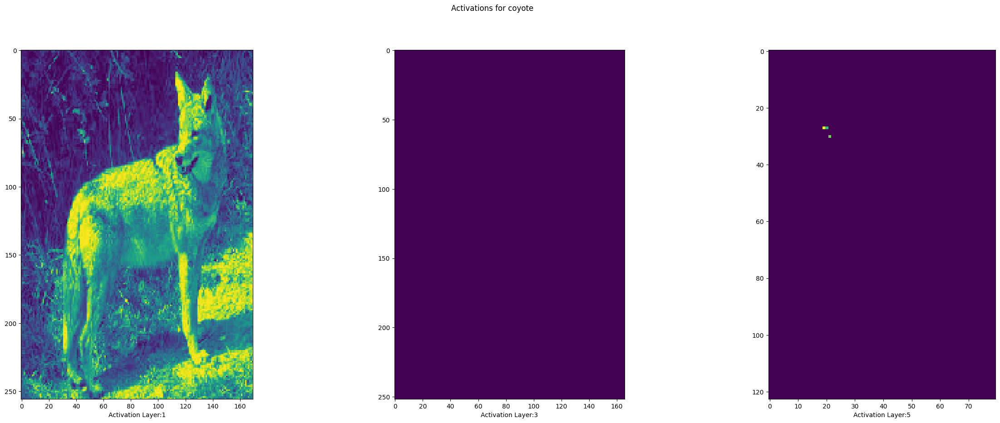

In [403]:
for Class in choosen_classes:
    
    train_path=os.path.join(five_class, "train")
    class_path=os.path.join(train_path, Class)
    image=os.listdir(class_path)[0]
    image_path=os.path.join(class_path, image)
    print(image_path)
    
    dataframe=pd.DataFrame([image_path], columns=["image_paths"])
    dataframe["labels"]=Class
    
    Data_Generator=data_generator(directory=class_path,x_col="image_paths",y_col="labels",dataframe=dataframe,
                        target_size=(img_width_resized,img_height_resized), classes=choosen_classes,class_mode="categorical",
                        color_mode="grayscale")
    
    weights_file=f"/kaggle/working/checkpoint_{Class}.h5"
    model.load_weights(weights_file)
    model.compile(optimizer=Optimizer, loss=Loss)


    layer_indices = [0, 2, 4] 
    sample_input=Data_Generator

    activation_models = [tf.keras.models.Model(inputs=model.input, outputs=model.layers[i].output) for i in layer_indices]

# Get the activations of the selected layers for the sample input
    activations = [activation_model.predict(sample_input) for activation_model in activation_models]

# Plot the activations
    j=0
    fig,ax=plt.subplots(1,3, figsize=(30, 10))
    for layer_index, activation in zip(layer_indices, activations):
        ax[j].imshow(activation[0, :, :, j], cmap='viridis')  # Assuming activations are 4D (batch_size, height, width, channels)
        ax[j].set_xlabel(f"Activation Layer:{layer_index+1}")
        j+=1
    fig.suptitle(f"Activations for {Class}")
    plt.show()

### Performing Multiclass Classification

In [16]:
input_shape=(img_width_resized,img_height_resized,1)

In [451]:
def multiclass_model():
    """
    Description: Multiclass model for classification
    
    Input: NONE
    
    Output: Model
    
    """
    inputs=tf.keras.Input(input_shape)
    x=tf.keras.layers.Conv2D(filters=128,kernel_size=(3,3),strides=(1,1),activation="relu")(inputs)
    x=tf.keras.layers.Conv2D(filters=128,kernel_size=(3,3),strides=(1,1),activation="relu")(x)
    x=tf.keras.layers.MaxPooling2D((3,3),strides=2)(x)
    
    x=tf.keras.layers.Conv2D(filters=64,kernel_size=(3,3),strides=(1,1),activation="relu")(x)
    x=tf.keras.layers.Conv2D(filters=64,kernel_size=(3,3),strides=(1,1),activation="relu")(x)
    x=tf.keras.layers.MaxPooling2D((3,3),strides=2)(x)
    x=tf.keras.layers.Dropout(0.25)(x)
    
    
    x=tf.keras.layers.Conv2D(filters=32,kernel_size=(3,3),strides=(1,1),activation="relu")(x)
    x=tf.keras.layers.MaxPooling2D((3,3),strides=2)(x)
    x=tf.keras.layers.Conv2D(filters=32,kernel_size=(3,3),strides=(1,1),activation="relu")(x)
    x=tf.keras.layers.MaxPooling2D((3,3),strides=2)(x)
    x=tf.keras.layers.Dropout(0.25)(x)
    
    x=tf.keras.layers.Flatten()(x)
    x=tf.keras.layers.Dense(20,activation="relu",kernel_regularizer=tf.keras.regularizers.l1(0.00001))(x)
    x=tf.keras.layers.Dense(5,activation="softmax")(x)
    
    return tf.keras.Model(inputs=inputs,outputs=x)

In [452]:
multic_model=multiclass_model()
multic_model.summary()

Model: "model_160"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_169 (InputLayer)      [(None, 256, 170, 1)]     0         
                                                                 
 conv2d_910 (Conv2D)         (None, 254, 168, 128)     1280      
                                                                 
 conv2d_911 (Conv2D)         (None, 252, 166, 128)     147584    
                                                                 
 max_pooling2d_615 (MaxPool  (None, 125, 82, 128)      0         
 ing2D)                                                          
                                                                 
 conv2d_912 (Conv2D)         (None, 123, 80, 64)       73792     
                                                                 
 conv2d_913 (Conv2D)         (None, 121, 78, 64)       36928     
                                                         

### Creating training data for data generators

In [435]:
image_paths=[]
labels=[]
train_path=os.path.join(five_class, "train")
for Class in choosen_classes:
    class_path=os.path.join(train_path, Class)
    
    for image in os.listdir(class_path):
        img_path=os.path.join(class_path, image)
        image_paths.append(img_path)
        labels.append(Class)
        
dataframe=pd.DataFrame(image_paths, columns=["image_paths"])
dataframe["labels"]=labels
dataframe = dataframe.sample(frac = 1)

### K-Fold Optimization for multiclass classification

In [394]:
#Implementing 3-Fold Stratified Cross Validation
def Multiclass_kfold_training(dataframe, directory, x_col_name, y_col_name, callbacks,augmentation=False, augmentation_params=None):
    Skfold=StratifiedKFold(n_splits=3,shuffle=True,random_state=42)
    x_col=np.array(dataframe[x_col_name])
    y_col=np.array(dataframe[y_col_name])
    histories=[]
    
    j=0
    for train_index, test_index in Skfold.split(x_col, y_col):
        print(f"Split:{j}")
        
        train_df=dataframe.iloc[train_index]
        test_df=dataframe.iloc[test_index]
        
        train_generator=data_generator(directory=directory,x_col=x_col_name,y_col=y_col_name,dataframe=train_df,
                        target_size=(img_width_resized,img_height_resized), classes=choosen_classes,class_mode="categorical",
                        color_mode="grayscale", augmentation=augmentation, augmentation_params=augmentation_params)
        
        test_generator=data_generator(directory=directory,x_col=x_col_name,y_col=y_col_name,dataframe=test_df,
                        target_size=(img_width_resized,img_height_resized), classes=choosen_classes,class_mode="categorical",
                        color_mode="grayscale")
        
        model=multiclass_model()
        model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.00015,use_ema=True), loss=tf.keras.losses.CategoricalCrossentropy(), metrics=[tfa.metrics.F1Score(num_classes=5, average='micro')])
        history=model.fit(train_generator, epochs=30,validation_data=test_generator,batch_size=batch_size,verbose=2,callbacks=callbacks)
        
        
        histories.append(history)
            
        j+=1
        
    return histories

In [395]:
def scheduler(epoch,lr):
    if epoch<5 or lr<=0.00006:
        return lr
    elif lr>0.00006:
        return lr*np.exp(-0.1)

In [396]:
learning_rate_scheduler=tf.keras.callbacks.LearningRateScheduler(schedule=scheduler,verbose=0)
callbacks=[learning_rate_scheduler]

In [ ]:
histories=Multiclass_kfold_training(dataframe, directory=train_path, x_col_name="image_paths", y_col_name="labels", 
                          callbacks=callbacks)

### Visualizing Results of Multiclass K-fold

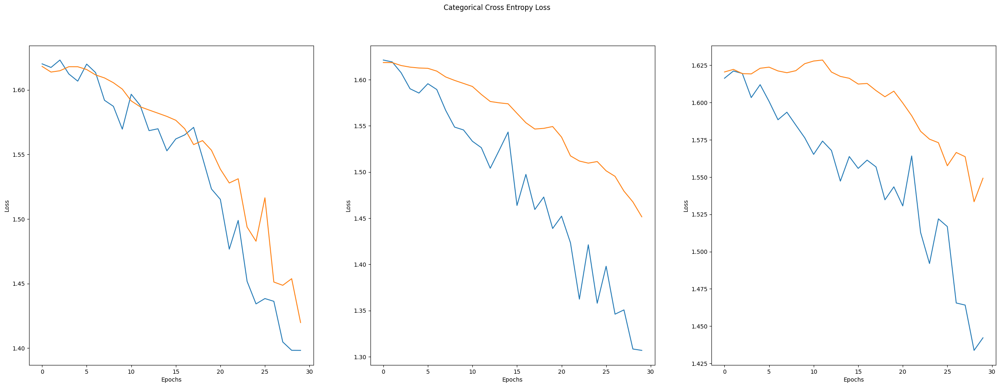

In [404]:
#Loss performance

fig, ax=plt.subplots(1,3, figsize=(30,10))
for i,history in enumerate(histories):
    ax[i].plot(np.arange(30), history.history["loss"])
    ax[i].plot(np.arange(30), history.history["val_loss"])
    ax[i].set_xlabel("Epochs")
    ax[i].set_ylabel("Loss")
    
fig.suptitle("Categorical Cross Entropy Loss")
plt.show()

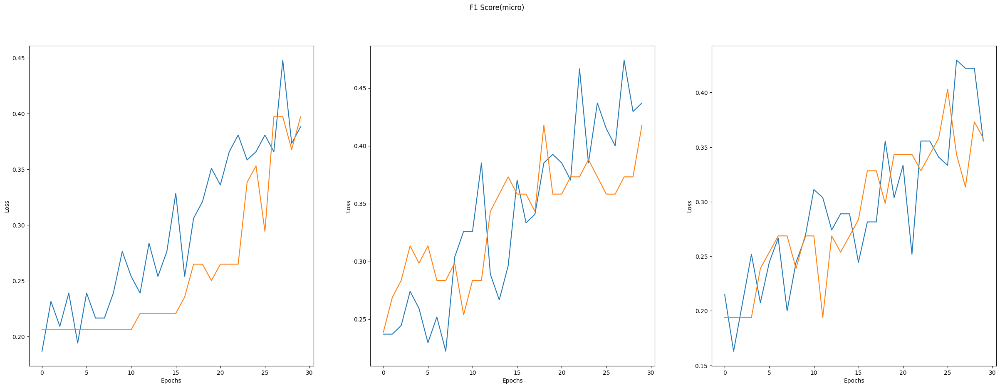

In [406]:
fig, ax=plt.subplots(1,3, figsize=(30,10))
for i,history in enumerate(histories):
    ax[i].plot(np.arange(30), history.history["f1_score"])
    ax[i].plot(np.arange(30), history.history["val_f1_score"])
    ax[i].set_xlabel("Epochs")
    ax[i].set_ylabel("Loss")
    
fig.suptitle("F1 Score(micro)")
plt.show()

### Training Final Model for Multiclass Classification

In [408]:
train_generator=data_generator(directory=train_path,x_col="image_paths",y_col="labels",dataframe=dataframe,
            target_size=(img_width_resized,img_height_resized), classes=choosen_classes,class_mode="categorical",
            color_mode="grayscale")

Found 202 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.


In [459]:
#Declaring training parameters

Epochs=60
Loss=tf.keras.losses.CategoricalCrossentropy()

In [460]:
learning_rate_scheduler=tf.keras.callbacks.LearningRateScheduler(schedule=scheduler,verbose=0)
early_stopping=tf.keras.callbacks.EarlyStopping(
    monitor="val_loss",
    min_delta=0,
    patience=5,
    verbose=0,
    mode="min",
    baseline=None,
    restore_best_weights=True,
    start_from_epoch=0,
)

callbacks=[early_stopping, learning_rate_scheduler]

In [ ]:
model=multiclass_model()
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.00015,use_ema=True), loss=Loss, metrics=[tfa.metrics.F1Score(num_classes=5, average='micro')])
history=model.fit(train_generator, epochs=Epochs,batch_size=batch_size,verbose=2, callbacks=callbacks)

In [480]:
model.save_weights(f"/kaggle/working/checkpoint_Classification.h5")

In [ ]:
"""
Model Log
--------------------------------------------------------------------------------------------------------
Loss function: Categorical Cross Entropy

Cross Validation method: Stratified-K Fold , K=3

Epochs: 60

Callbacks: Early Stopping to prevent overfitting
           Learning Rate Scheduler as the model would often overshoot from the middle phase

Overfiiting: The model overfits quite a bit due to the dataset being too shallow for learning rich features
             as increasing the model size led to overfitting. Data Augmentation doesn't help much either
             some other methods can be used to increase the performance but couldn't due to lack of time.
           
"""

### Evaluating on test dataset

In [462]:
#Test dataset
image_paths=[]
labels=[]
test_path=os.path.join(five_class, "test")
for Class in choosen_classes:
    class_path=os.path.join(test_path, Class)
    
    for image in os.listdir(class_path):
        img_path=os.path.join(class_path, image)
        image_paths.append(img_path)
        labels.append(Class)
        
dataframe=pd.DataFrame(image_paths, columns=["image_paths"])
dataframe["labels"]=labels
dataframe = dataframe.sample(frac = 1)

In [463]:
test_generator=data_generator(directory=test_path,x_col="image_paths",y_col="labels",dataframe=dataframe,
            target_size=(img_width_resized,img_height_resized), classes=choosen_classes,class_mode="categorical",
            color_mode="grayscale")

Found 48 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.


In [478]:
#Evaluating on test dataset
model.evaluate(test_generator)

2/2 [==============================] - 0s 73ms/step - loss: 1.5003 - f1_score: 0.4167


[1.5003137588500977, 0.4166666567325592]

In [476]:
predictions=model.predict(test_generator)
y_pred_classification=np.argmax(np.array(predictions), axis=1)
y_true_classification=test_generator.labels

2/2 [==============================] - 0s 98ms/step


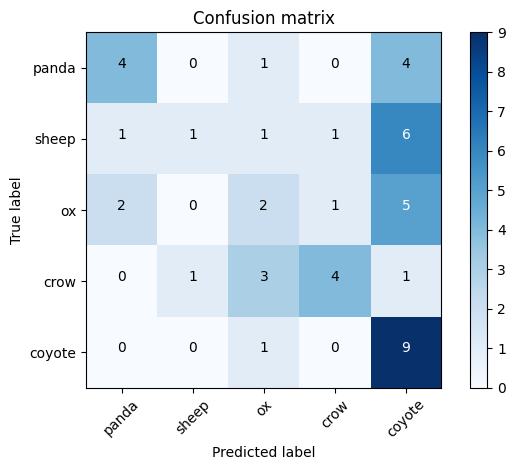

In [477]:
#Confusion Matrix
cm=confusion_matrix(y_true_classification, y_pred_classification)

# Plot confusion matrix
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion matrix')
plt.colorbar()

classes = choosen_classes
tick_marks = np.arange(len(classes))

plt.xticks(tick_marks, classes, rotation=45)
plt.yticks(tick_marks, classes)

plt.ylabel('True label')
plt.xlabel('Predicted label')

# Print the confusion matrix values
for i in range(len(classes)):
    for j in range(len(classes)):
        plt.text(j, i, cm[i, j], horizontalalignment='center', color='white' if cm[i, j] > cm.max() / 2 else 'black')

plt.tight_layout()
plt.show()

Found 1 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.
1/1 [==============================] - 0s 146ms/step


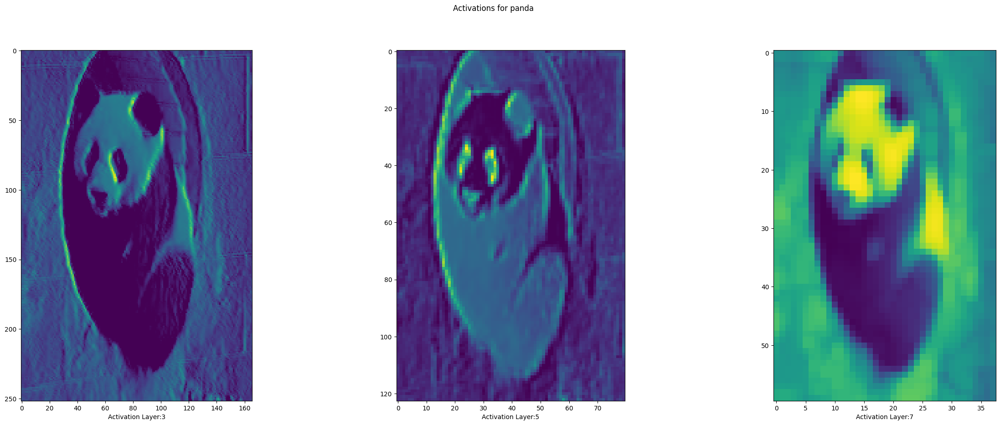

Found 1 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.
1/1 [==============================] - 0s 87ms/step


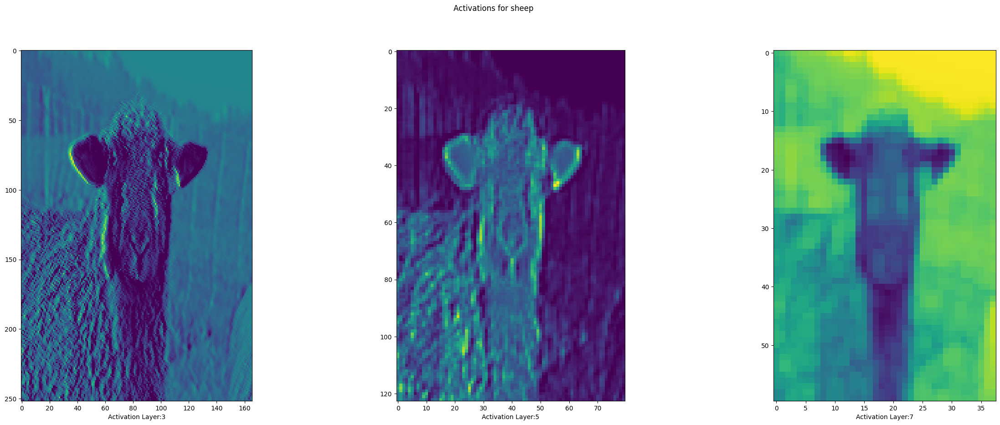

Found 1 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.
1/1 [==============================] - 0s 81ms/step


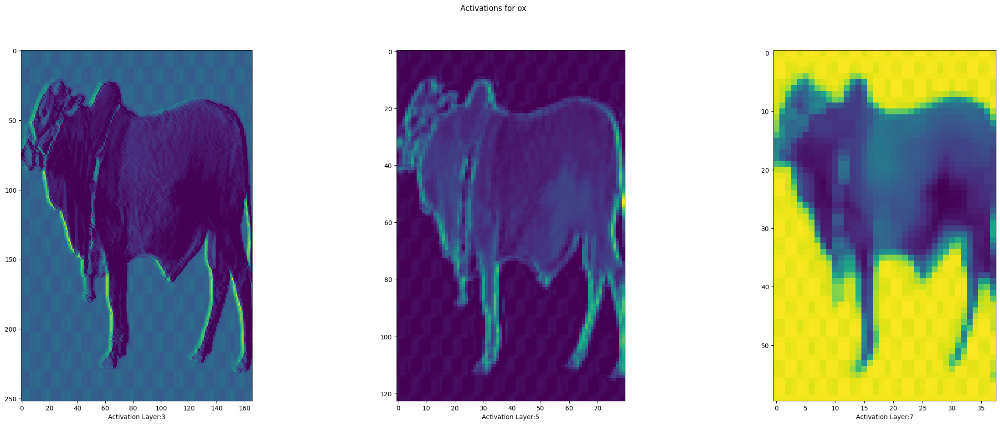

Found 1 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.
1/1 [==============================] - 0s 78ms/step


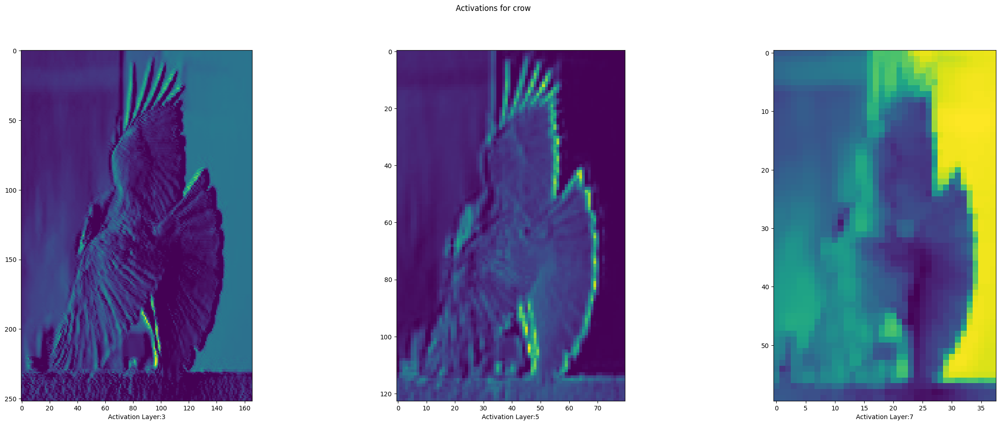

Found 1 validated image filenames belonging to 5 classes.
Found 0 validated image filenames belonging to 5 classes.
1/1 [==============================] - 0s 73ms/step


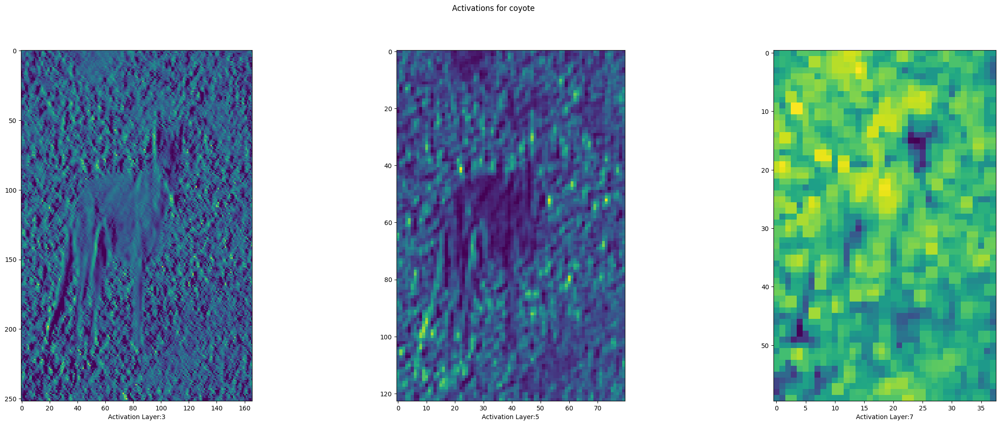

In [483]:
#Visualizing outputs
for Class in choosen_classes:
    train_path=os.path.join(five_class, "train")
    class_path=os.path.join(test_path, Class)
    image=os.listdir(class_path)[0]
    image_path=os.path.join(class_path, image)

    
    dataframe=pd.DataFrame([image_path], columns=["image_paths"])
    dataframe["labels"]=Class
    
    Data_Generator=data_generator(directory=class_path,x_col="image_paths",y_col="labels",dataframe=dataframe,
                        target_size=(img_width_resized,img_height_resized), classes=choosen_classes,class_mode="categorical",
                        color_mode="grayscale")

    layer_indices = [2, 4, 6] 
    sample_input=Data_Generator

    activation_models = [tf.keras.models.Model(inputs=model.input, outputs=model.layers[i].output) for i in layer_indices]

# Get the activations of the selected layers for the sample input
    activations = [activation_model.predict(sample_input) for activation_model in activation_models]

# Plot the activations
    j=0
    fig,ax=plt.subplots(1,3, figsize=(30, 10))
    for layer_index, activation in zip(layer_indices, activations):
        ax[j].imshow(activation[0, :, :, j], cmap='viridis')  # Assuming activations are 4D (batch_size, height, width, channels)
        ax[j].set_xlabel(f"Activation Layer:{layer_index+1}")
        j+=1
    fig.suptitle(f"Activations for {Class}")
    plt.show()

In [ ]:
"""
Final Verdict
--------------------------------------------------------------------------------------------------------

1) One Vs Rest

The method works slightly better here than the multiclassification with the following scores on the test 
set
    
    F1 Score(micro): 0.542

However, it is a lot more difficult to train as there is one model to be trained for each individual class
soo you want to make sure that each model performs decently. However due to the dataset being too small
this model also performs decent at best.

2) Multiclass 

The method resulted in quite a bit of overfitting again majorly due to the small size of the dataset.It 
got the following score on the test set

    F1 Score(micro): 0.412
    
The model was lot more easier to train and handle overall, and is definitely the more practical choice among 
the two methods.

Final Statement: I really enjoyed working on this project and learned quite a few things there are quite
a few more things I would like to try that could potentially improve the performance but couldn't due to 
time constraints as I had my mid semesters going on. Thank you 
"""